In [ ]:
import pandas as pd
import altair as alt

In [ ]:
#data = pd.read_csv("Gesamtdatensatz.csv")
data = pd.read_json("Teildatensatz.json")
data.head(n=100)
#print(data.iloc[400])
print(data['weather_condition'].unique())


In [ ]:
alt.Chart(data).mark_point().encode(x = 'timestamp:T', y = 'pedestrians_count', color = 'location_id:N').interactive()

In [ ]:
data['hour'] = data['timestamp'].dt.hour

base = alt.Chart(data).add_params().properties(width=600, height=400)

filter_exp = "(datum.year ==  2024) && (datum.month == 4) && (datum.day == 15) && (datum.location_id == 329)"

temp_left = base.transform_filter(filter_exp).encode(alt.Y('hour:O'), alt.Color('temperature:Q').sort('descending')).mark_rect(opacity=0.5)
temp_right = base.transform_filter(filter_exp).encode(alt.Y('hour:O'), alt.Color('temperature:Q')).mark_rect(opacity=0.5)

left = base.transform_filter(filter_exp).encode(alt.Y('hour:O').axis(None), alt.X('sum(ltr_pedestrians_count):Q').title('Left to Right').sort('descending')).mark_rect()
right = base.transform_filter(filter_exp).encode(alt.Y('hour:O').axis(None), alt.X('sum(ltr_pedestrians_count):Q').title('Rigth to Left')).mark_rect()
middle = base.transform_aggregate(location_name='max(location_name)', groupby=['location_id']).encode(alt.Y('location_id:N').axis(None), alt.Text('location_name:N')).mark_text(fontSize=15, font='Bahnschrift').properties(width=200)

left_chart = alt.layer(left, temp_left)
right_chart = alt.layer(right, temp_right)
#left_chart = alt.layer(temp_left, left)
#right_chart = alt.layer(temp_right, right)


main_chart = alt.concat(left_chart, middle, right_chart, spacing = 5)
main_chart

In [ ]:
# Add hour column to table
data['hour'] = data['timestamp'].dt.hour
data['pedestrian_grey'] = data[['ltr_pedestrians_count', 'rtl_pedestrians_count']].min(axis=1)

# Set variables from Frontent
year = 2022
month = 10
day = 15
location_id = 329
titel_links = 'Hauptbahnhof'
titel_rechts = 'Bürkliplatz'
titel_chart = 'Bahnhofstrasse (Mitte)'
# Initialize Basic Chart
base = alt.Chart(data).add_params().properties(width=400, height=24*30)

# Set re-used chart expressions
filter_exp = f"(datum.year ==  {year}) && (datum.month == {month}) && (datum.day == {day}) && (datum.location_id == {location_id})"

# Build Temperature chart for Background
temp_left = base.transform_filter(filter_exp).encode(
    alt.Y('hour:T').axis(None), 
    alt.Color('temperature:Q')
        #.bin(maxbins=10, extent=[-10,35])
        .scale(scheme='blueorange', domain=[-10,35], type="linear")).mark_rect(
            #opacity=0.5,
            height=30)

temp_right = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.Color('temperature:Q')
        #.bin(maxbins=10, extent=[-10,35])
        .scale(scheme='blueorange', domain=[-10,35], type="linear")).mark_rect(
            #opacity=0.1,
            height=30)

# Build Pedestrian-count chart
left = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None), 
    alt.X('sum(ltr_pedestrians_count):Q')
        .axis(title=f'Passanten in Richtung {titel_links}',
            titleFont='Bahnschrift',
            titleFontSize = 14,
            titlePadding = 10)).mark_bar(
                color='darkred',
                height=20).properties(
                    #title=alt.Title(
                        #titel_links,
                        #anchor='middle',
                        #fontSize=20,
                        #font='Bahnschrift',
                        #offset=5)
                        )

right = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None), 
    alt.X('sum(rtl_pedestrians_count):Q')
        .axis(title=f'Passanten in Richtung {titel_rechts}',
            titleFont='Bahnschrift',
            titleFontSize = 14,
            titlePadding = 10)).mark_bar(
            color='darkred', 
            height=20).properties(
                #title=alt.Title(
                    #titel_rechts, 
                    #anchor='middle', 
                    #fontSize=20, 
                    #font='Bahnschrift', 
                    #offset=5)
                    )

# Build Pedestrian-even count chart
left_g = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.X('sum(pedestrian_grey):Q')
        .sort('descending')).mark_bar(
            color='lightgray',
            height=20)

right_g = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.X('sum(pedestrian_grey):Q')).mark_bar(
            color='lightgray',
            height=20)

# Build middle chart (legend)
middle = base.transform_aggregate(groupby=['hour', 'location_id']).encode(
    alt.Y('hour:O').axis(None),
    alt.Text('hour:O')).mark_text(
        fontSize=15,
        font='Bahnschrift').properties(width=20)

# Layer Charts
left_chart = alt.layer(temp_left, left, left_g)
right_chart = alt.layer(temp_right, right, right_g)

# Concatenate Charts
main_chart = alt.concat(left_chart, middle, right_chart, spacing = 5).properties(
    title=alt.Title(
        titel_chart,
        anchor='middle',
        fontSize=30,
        font='Bahnschrift',
        offset=30))
main_chart

In [ ]:
import base64
import os

from io import BytesIO
from PIL import Image


image_paths = ["assets/clear-day.png","assets/clear-night.png", "assets/cloudy.png", "assets/fog.png", "assets/partly-cloudy-day.png", "assets/partly-cloudy-night.png", "assets/rain.png", "assets/snow.png"]
base64_images = {}

for image_path in image_paths:
    # Schlüssel aus Dateiname extrahieren (ohne Ordner und ohne .png)
    key = os.path.splitext(os.path.basename(image_path))[0]
    
    pil_image = Image.open(image_path)
    output = BytesIO()
    pil_image.save(output, format='PNG')
    
    # Base64-String in das Dictionary einfügen
    base64_images[key] = "data:image/png;base64," + base64.b64encode(output.getvalue()).decode()



# Add columns to table
data['hour'] = data['timestamp'].dt.hour
data['pedestrian_grey'] = data[['ltr_pedestrians_count', 'rtl_pedestrians_count']].min(axis=1)
data['pedestrian_diff'] = ((data['ltr_pedestrians_count'] - data['rtl_pedestrians_count'])**2)**0.5
data['weather_icon'] = data['weather_condition'].map(base64_images)

# Set variables from Frontent
year = 2021
month = 10
day = 15
location_id = 329
titel_links = 'Hauptbahnhof'
titel_rechts = 'Bürkliplatz'
titel_chart = 'Bahnhofstrasse (Mitte)'
# Initialize Basic Chart
base = alt.Chart(data).add_params().properties(width=400, height=24*30)

# Set re-used chart expressions
filter_exp = f"(datum.year ==  {year}) && (datum.month == {month}) && (datum.day == {day}) && (datum.location_id == {location_id})"

# Build Temperature chart for Background
temp_left = base.transform_filter(filter_exp).encode(
    alt.Y('hour:T').axis(None), 
    alt.Color('temperature:Q')
        #.bin(maxbins=10, extent=[-10,35])
        .scale(scheme='blueorange', domain=[-10,35], type="linear"),
    tooltip=[alt.Tooltip('temperature:Q', 
            title='Temperatur [°C]:', 
            format=".1f")]).mark_rect(
        #opacity=0.5,
        height=30).interactive()

temp_right = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.Color('temperature:Q')
        #.bin(maxbins=10, extent=[-10,35])
        .scale(scheme='blueorange', domain=[-10,35], type="linear"),
    tooltip=[alt.Tooltip('temperature:Q',
            title='Temperatur [°C]:',
            format=".1f")]).mark_rect(
            #opacity=0.1,
            height=30).interactive()

# Build Pedestrian-count chart
left = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None), 
    alt.X('ltr_pedestrians_count:Q')
        .axis(title=f'Passanten in Richtung {titel_links}',
            titleFont='Bahnschrift',
            titleFontSize = 14,
            titlePadding = 10),
    tooltip=[alt.Tooltip('pedestrian_diff:Q',
        title=f'Passanten mehr in Richtung {titel_links} als {titel_rechts}')]).mark_bar(
                color='darkred',
                height=20).properties(
                    #title=alt.Title(
                        #titel_links,
                        #anchor='middle',
                        #fontSize=20,
                        #font='Bahnschrift',
                        #offset=5)
                        ).interactive()

right = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None), 
    alt.X('rtl_pedestrians_count:Q')
        .axis(title=f'Passanten in Richtung {titel_rechts}',
            titleFont='Bahnschrift',
            titleFontSize = 14,
            titlePadding = 10),
    tooltip=[alt.Tooltip('pedestrian_diff:Q',
        title=f'Passanten mehr in Richtung {titel_rechts} als {titel_links}')]).mark_bar(
            color='darkred', 
            height=20).properties(
                #title=alt.Title(
                    #titel_rechts, 
                    #anchor='middle', 
                    #fontSize=20, 
                    #font='Bahnschrift', 
                    #offset=5)
                    ).interactive()

# Build Pedestrian-even count chart
left_g = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.X('sum(pedestrian_grey):Q')
        .sort('descending'),
    tooltip=[alt.Tooltip('ltr_pedestrians_count:Q',
        title=f'Passanten in Richtung {titel_links}')]).mark_bar(
            color='dimgray',
            height=20)

right_g = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.X('sum(pedestrian_grey):Q'),
    tooltip=[alt.Tooltip('rtl_pedestrians_count:Q',
        title=f'Passanten in Richtung {titel_rechts}')]).mark_bar(
            color='dimgray',
            height=20)

# weather icon chart
weather = base.transform_filter(filter_exp).transform_aggregate(
    weather_icon='max(weather_icon)',
    groupby=['hour', 'location_id']
).encode(
    alt.Y('hour:O').axis(None),
    url='weather_icon:N'
).mark_image(width=25, height=25).properties(width=30)

# Build middle chart (legend)
middle = base.transform_aggregate(groupby=['hour', 'location_id']).encode(
    alt.Y('hour:O').axis(None),
    alt.Text('hour:O')).mark_text(
        fontSize=15,
        font='Bahnschrift').properties(width=20)


# Layer Charts
left_chart = alt.layer(temp_left, left, left_g)
right_chart = alt.layer(temp_right, right, right_g)

# Concatenate Charts
main_chart = alt.concat(weather, left_chart, middle, right_chart, spacing = 5).properties(
    title=alt.Title(
        titel_chart,
        anchor='middle',
        fontSize=30,
        font='Bahnschrift',
        offset=30))
main_chart

#https://altair-viz.github.io/user_guide/marks/image.html


alt.ConcatChart(...)
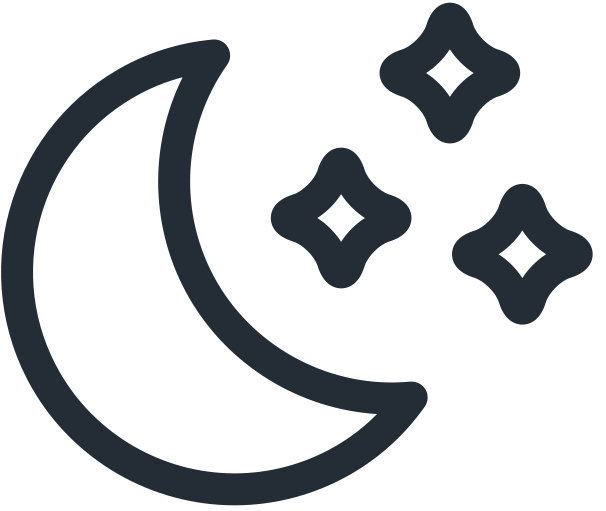
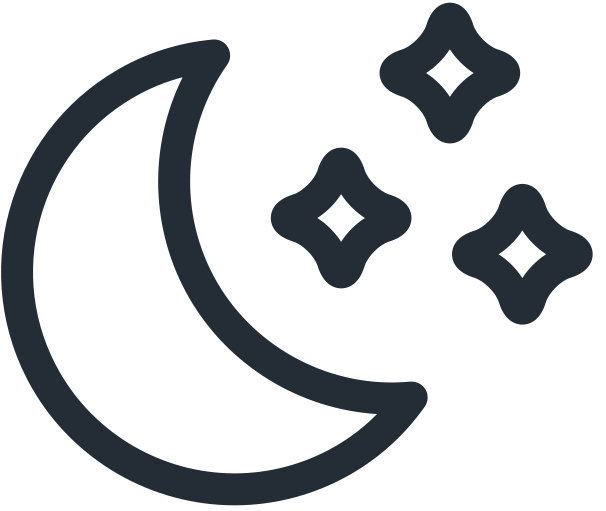
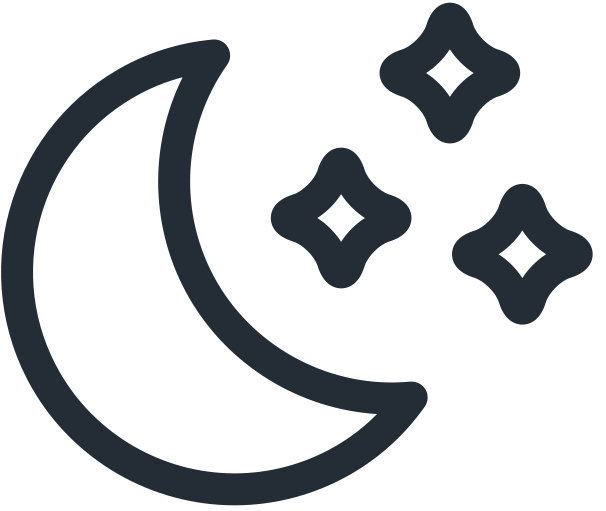
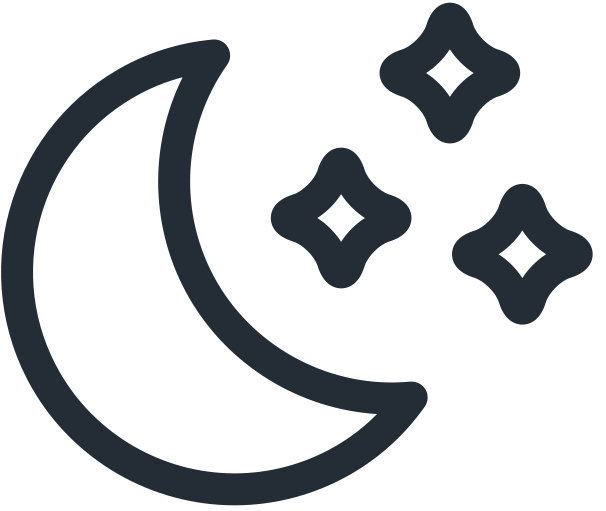
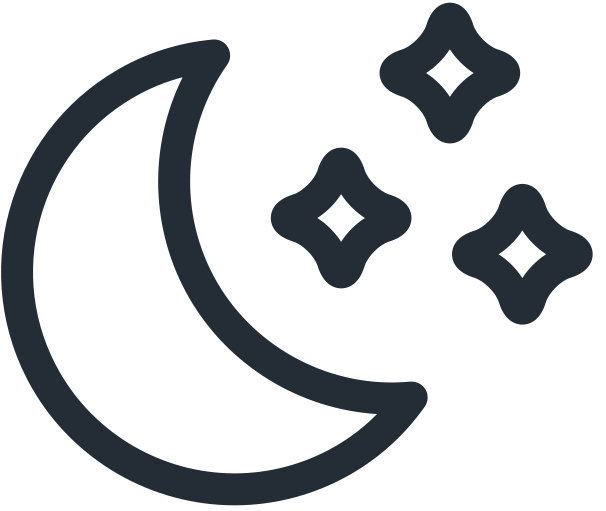
...
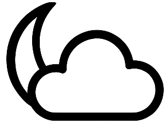
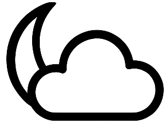
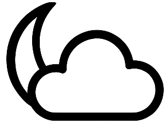
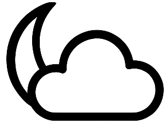
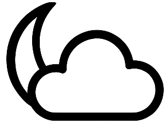

In [36]:
import base64
import os

from io import BytesIO
from PIL import Image


image_paths = ["assets/clear-day.png","assets/clear-night.png", "assets/cloudy.png", "assets/fog.png", "assets/partly-cloudy-day.png", "assets/partly-cloudy-night.png", "assets/rain.png", "assets/snow.png"]
base64_images = {}

for image_path in image_paths:
    # Schlüssel aus Dateiname extrahieren (ohne Ordner und ohne .png)
    key = os.path.splitext(os.path.basename(image_path))[0]
    
    pil_image = Image.open(image_path)
    output = BytesIO()
    pil_image.save(output, format='PNG')
    
    # Base64-String in das Dictionary einfügen
    base64_images[key] = "data:image/png;base64," + base64.b64encode(output.getvalue()).decode()



# Add columns to table
data['hour'] = data['timestamp'].dt.hour
data['pedestrian_grey'] = data[['ltr_pedestrians_count', 'rtl_pedestrians_count']].min(axis=1)
data['pedestrian_diff'] = ((data['ltr_pedestrians_count'] - data['rtl_pedestrians_count'])**2)**0.5
data['weather_icon'] = data['weather_condition'].map(base64_images)

# Set variables from Frontent
year = 2021
month = 10
day = 15
location_id = 329
titel_links = 'Hauptbahnhof'
titel_rechts = 'Bürkliplatz'
titel_chart = 'Bahnhofstrasse (Mitte)'
# Initialize Basic Chart
base = alt.Chart(data).add_params().properties(width=400, height=24*30)

# get data for common x-axis:
data_filtered = data[
    (data['timestamp'].dt.year == year) &
    (data['timestamp'].dt.month == month) &
    (data['timestamp'].dt.day == day) &
    (data['location_id'] == location_id)
]
max_val = data_filtered[['ltr_pedestrians_count', 'rtl_pedestrians_count']].max().max()
shared_scale = alt.Scale(domain=(0, max_val + 100))

# Set re-used chart expressions
filter_exp = f"(datum.year ==  {year}) && (datum.month == {month}) && (datum.day == {day}) && (datum.location_id == {location_id})"

# Build Temperature chart for Background
temp_left = base.transform_filter(filter_exp).encode(
    alt.Y('hour:T').axis(None), 
    alt.Color('temperature:Q')
        #.bin(maxbins=10, extent=[-10,35])
        .scale(scheme='blueorange', domain=[-10,35], type="linear"),
    tooltip=[alt.Tooltip('temperature:Q', 
            title='Temperatur [°C]:', 
            format=".1f")]).mark_rect(
        #opacity=0.5,
        height=30).interactive()

temp_right = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.Color('temperature:Q')
        #.bin(maxbins=10, extent=[-10,35])
        .scale(scheme='blueorange', domain=[-10,35], type="linear"),
    tooltip=[alt.Tooltip('temperature:Q',
            title='Temperatur [°C]:',
            format=".1f")]).mark_rect(
            #opacity=0.1,
            height=30).interactive()

# Build Pedestrian-count chart
left = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None), 
    alt.X('ltr_pedestrians_count:Q', scale=shared_scale)
        .axis(title=f'Passanten in Richtung {titel_links}',
            titleFont='Bahnschrift',
            titleFontSize = 14,
            titlePadding = 10),
    tooltip=[alt.Tooltip('pedestrian_diff:Q',
        title=f'Passanten mehr in Richtung {titel_links} als {titel_rechts}')]).mark_bar(
                color='darkred',
                height=20).properties(
                    #title=alt.Title(
                        #titel_links,
                        #anchor='middle',
                        #fontSize=20,
                        #font='Bahnschrift',
                        #offset=5)
                        ).interactive()

right = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None), 
    alt.X('rtl_pedestrians_count:Q', scale=shared_scale)
        .axis(title=f'Passanten in Richtung {titel_rechts}',
            titleFont='Bahnschrift',
            titleFontSize = 14,
            titlePadding = 10),
    tooltip=[alt.Tooltip('pedestrian_diff:Q',
        title=f'Passanten mehr in Richtung {titel_rechts} als {titel_links}')]).mark_bar(
            color='darkred', 
            height=20).properties(
                #title=alt.Title(
                    #titel_rechts, 
                    #anchor='middle', 
                    #fontSize=20, 
                    #font='Bahnschrift', 
                    #offset=5)
                    ).interactive()

# Build Pedestrian-even count chart
left_g = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.X('sum(pedestrian_grey):Q', scale=shared_scale)
        .sort('descending'),
    tooltip=[alt.Tooltip('ltr_pedestrians_count:Q',
        title=f'Passanten in Richtung {titel_links}')]).mark_bar(
            color='dimgray',
            height=20)

right_g = base.transform_filter(filter_exp).encode(
    alt.Y('hour:O').axis(None),
    alt.X('sum(pedestrian_grey):Q', scale=shared_scale),
    tooltip=[alt.Tooltip('rtl_pedestrians_count:Q',
        title=f'Passanten in Richtung {titel_rechts}')]).mark_bar(
            color='dimgray',
            height=20)

# weather icon chart
weather = base.transform_filter(filter_exp).transform_aggregate(
    weather_icon='max(weather_icon)',
    groupby=['hour', 'location_id']
).encode(
    alt.Y('hour:O').axis(None),
    url='weather_icon:N'
).mark_image(width=25, height=25).properties(width=30)

# Build middle chart (legend)
middle = base.transform_aggregate(groupby=['hour', 'location_id']).encode(
    alt.Y('hour:O').axis(None),
    alt.Text('hour:O')).mark_text(
        fontSize=15,
        font='Bahnschrift').properties(width=20)


# Layer Charts
left_chart = alt.layer(temp_left, left, left_g)
right_chart = alt.layer(temp_right, right, right_g)

# Concatenate Charts
main_chart = alt.concat(weather, left_chart, middle, right_chart, spacing = 5,).properties(
    title=alt.Title(
        titel_chart,
        anchor='middle',
        fontSize=30,
        font='Bahnschrift',
        offset=30))
main_chart

#https://altair-viz.github.io/user_guide/marks/image.html
